In [1]:
import torch
import torch.nn as nn
import os
import xml.etree.ElementTree as ET
from PIL import Image
from torchvision import transforms
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import random
import torch.optim as optim
from torchvision.utils import make_grid
from tqdm import tqdm
import time
import torchvision.transforms.functional as TF

описываем классы для дискриминатора, генератора

In [2]:
class ConditionalBatchNorm2d(nn.Module):
    def __init__(self, num_features, num_classes):
        super().__init__()
        self.bn = nn.BatchNorm2d(num_features, affine=False)
        self.gamma = nn.Embedding(num_classes, num_features)
        self.beta = nn.Embedding(num_classes, num_features)

        nn.init.ones_(self.gamma.weight)
        nn.init.zeros_(self.beta.weight)

    def forward(self, x, y):
        out = self.bn(x)
        gamma = self.gamma(y).unsqueeze(2).unsqueeze(3)
        beta = self.beta(y).unsqueeze(2).unsqueeze(3)
        return gamma * out + beta


In [3]:
class Discriminator(nn.Module):
    def __init__(self, num_classes=120):
        super().__init__()

        def block(in_channels, out_channels):
            return nn.Sequential(
                nn.Conv2d(in_channels, out_channels, 4, 2, 1),
                nn.BatchNorm2d(out_channels),
                nn.LeakyReLU(0.2, inplace=True)
            )

        self.conv = nn.Sequential(
            block(3, 64),    # 32x32
            block(64, 128),  # 16x16
            block(128, 256), # 8x8
            block(256, 512), # 4x4
        )

        self.real_fake = nn.Sequential(
            nn.Conv2d(512, 1, 4),
            nn.Sigmoid()
        )

        self.classifier = nn.Sequential(
            nn.Flatten(),
            nn.Linear(512 * 4 * 4, num_classes)
        )

    def forward(self, x):
        features = self.conv(x)
        rf_output = self.real_fake(features).view(-1)
        class_output = self.classifier(features)
        return rf_output, class_output

In [4]:
class Generator(nn.Module):
    def __init__(self, noise_dim=100, num_classes=120):
        super().__init__()
        self.label_emb = nn.Embedding(num_classes, num_classes)

        self.project = nn.Linear(noise_dim + num_classes, 1024 * 4 * 4)

        self.upsample = nn.Sequential(
            nn.ConvTranspose2d(1024, 512, 4, 2, 1),  # 8x8
            nn.ReLU(True),

            nn.ConvTranspose2d(512, 256, 4, 2, 1),  # 16x16
            nn.ReLU(True),

            nn.ConvTranspose2d(256, 128, 4, 2, 1),  # 32x32
            nn.ReLU(True),

            nn.ConvTranspose2d(128, 3, 4, 2, 1),    # 64x64
            nn.Tanh()
        )

        self.cbn1 = ConditionalBatchNorm2d(512, num_classes)
        self.cbn2 = ConditionalBatchNorm2d(256, num_classes)
        self.cbn3 = ConditionalBatchNorm2d(128, num_classes)

    def forward(self, z, labels):
        emb = self.label_emb(labels)
        x = torch.cat([z, emb], dim=1)
        x = self.project(x).view(-1, 1024, 4, 4)

        x = self.upsample[0](x)
        x = self.cbn1(x, labels)
        x = self.upsample[1](x)

        x = self.upsample[2](x)
        x = self.cbn2(x, labels)
        x = self.upsample[3](x)

        x = self.upsample[4](x)
        x = self.cbn3(x, labels)
        x = self.upsample[5](x)

        x = self.upsample[6](x)
        return x


сделаем класс для датасета

In [47]:
class DogDataset(Dataset):
    def __init__(self, image_root, annotation_root, transform=None):
        self.image_root = image_root
        self.annotation_root = annotation_root
        self.transform = transform
        self.samples = []

        self.class_names = sorted([folder for folder in os.listdir(image_root) if os.path.isdir(os.path.join(image_root, folder))])
        self.class_to_idx = {name: idx for idx, name in enumerate(self.class_names)}

        for class_folder in self.class_names:
            image_folder_path = os.path.join(image_root, class_folder)
            annotation_folder_path = os.path.join(annotation_root, class_folder)
        
            for filename in os.listdir(image_folder_path):
                if not filename.endswith('.jpg'):
                    continue
                image_path = os.path.join(image_folder_path, filename)
                base_filename = os.path.splitext(filename)[0]
                annotation_path = os.path.join(annotation_folder_path, f"{base_filename}")
        
                if not os.path.exists(annotation_path):
                    print(f"[Пропуск] Нет аннотации для: {filename}")
                    continue
        
                try:
                    tree = ET.parse(annotation_path)
                    root = tree.getroot()
                    obj = root.find("object")
                    if obj is None:
                        print(f"[Пропуск] Нет объекта в аннотации: {annotation_path}")
                        continue
        
                    bndbox = obj.find("bndbox")
                    if bndbox is None:
                        print(f"[Пропуск] Нет bndbox в аннотации: {annotation_path}")
                        continue
        
                    bbox = (
                        int(bndbox.find("xmin").text),
                        int(bndbox.find("ymin").text),
                        int(bndbox.find("xmax").text),
                        int(bndbox.find("ymax").text)
                    )
                    label = self.class_to_idx[class_folder]
                    self.samples.append((image_path, bbox, label))
                except Exception as e:
                    print(f"[Ошибка] {annotation_path}: {e}")
                    continue

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        #print(f"[INFO] Загружается элемент {idx}") 
        image_path, bbox, label = self.samples[idx]
        image = Image.open(image_path).convert('RGB')
        cropped = image.crop(bbox)

        if self.transform:
            cropped = self.transform(cropped)

        return cropped, label


transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize([0.5]*3, [0.5]*3)
])

создаем датасет и смотрим примеры

In [52]:
dataset = DogDataset('8lab//Images', '8lab//Annotation', transform=transform)
dataloader = DataLoader(dataset, batch_size=64, shuffle=True, num_workers=0)

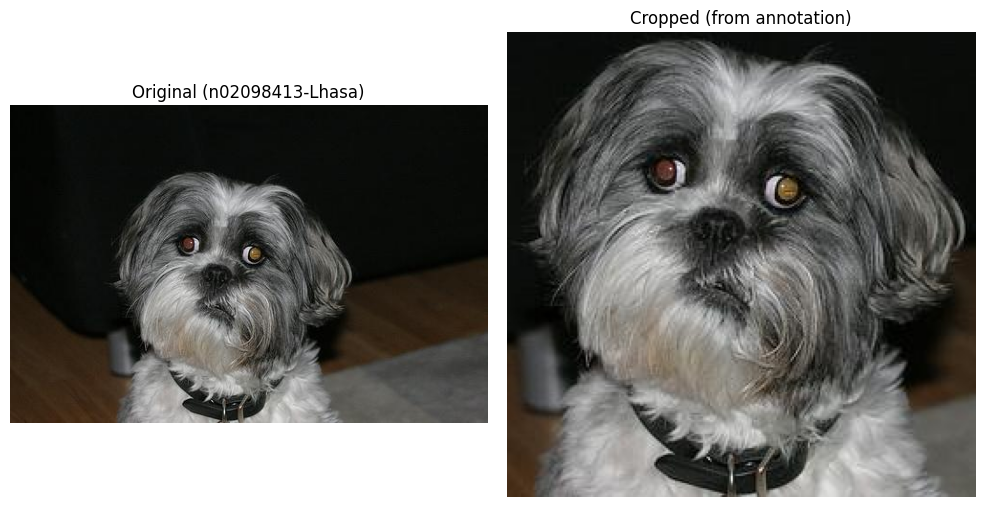

In [53]:
def show_sample(dataset):
    idx = random.randint(0, len(dataset) - 1)
    image_path, bbox, label = dataset.samples[idx]

    image = Image.open(image_path).convert('RGB')

    cropped = image.crop(bbox)

    breed_name = dataset.class_names[label]

    fig, axs = plt.subplots(1, 2, figsize=(10, 5))

    axs[0].imshow(image)
    axs[0].set_title(f"Original ({breed_name})")
    axs[0].axis("off")

    axs[1].imshow(cropped)
    axs[1].set_title("Cropped (from annotation)")
    axs[1].axis("off")

    plt.tight_layout()
    plt.show()

show_sample(dataset)

описываем как мы будем тренировать модель, тобиж функцию трайн

In [10]:
def train_cgan(generator, discriminator, dataloader, num_epochs=50, noise_dim=100, num_classes=120, device='cuda'):
    generator = generator.to(device)
    discriminator = discriminator.to(device)

    criterion_bce = nn.BCELoss()
    criterion_ce = nn.CrossEntropyLoss()

    optimizer_G = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
    optimizer_D = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

    fixed_noise = torch.randn(16, noise_dim, device=device)
    fixed_labels = torch.randint(0, num_classes, (16,), device=device)

    for epoch in range(num_epochs):
        start_time = time.time()
        progress = tqdm(dataloader, desc=f"Epoch {epoch+1}/{num_epochs}", leave=False)

        for i, (real_imgs, labels) in enumerate(progress):
            batch_size = real_imgs.size(0)
            real_imgs = real_imgs.to(device)
            labels = labels.to(device)

            valid = torch.ones(batch_size, device=device)
            fake = torch.zeros(batch_size, device=device)

            optimizer_D.zero_grad()

            z = torch.randn(batch_size, noise_dim, device=device)
            gen_imgs = generator(z, labels)

            real_pred, real_cls = discriminator(real_imgs)
            fake_pred, _ = discriminator(gen_imgs.detach())

            d_real_loss = criterion_bce(real_pred, valid)
            d_fake_loss = criterion_bce(fake_pred, fake)
            d_cls_loss = criterion_ce(real_cls, labels)

            d_loss = d_real_loss + d_fake_loss + d_cls_loss
            d_loss.backward()
            optimizer_D.step()

            optimizer_G.zero_grad()
            gen_pred, gen_cls = discriminator(gen_imgs)

            g_adv_loss = criterion_bce(gen_pred, valid)
            g_cls_loss = criterion_ce(gen_cls, labels)

            g_loss = g_adv_loss + g_cls_loss
            g_loss.backward()
            optimizer_G.step()

            progress.set_postfix(D_loss=d_loss.item(), G_loss=g_loss.item())

        end_time = time.time()
        print(f"Epoch {epoch+1}/{num_epochs} completed in {end_time - start_time:.2f}s")

        if (epoch + 1) % 10 == 0 or epoch == 0:
            visualize_generated(generator, fixed_noise, fixed_labels, epoch+1, device)

def visualize_generated(generator, noise, labels, epoch, device):
    generator.eval()
    with torch.no_grad():
        gen_imgs = generator(noise, labels)
        gen_imgs = gen_imgs * 0.5 + 0.5  # [-1,1] → [0,1]

    grid = make_grid(gen_imgs.cpu(), nrow=4)
    plt.figure(figsize=(8, 8))
    plt.imshow(grid.permute(1, 2, 0))
    plt.title(f"Generated Samples (Epoch {epoch})")
    plt.axis("off")
    plt.show()
    generator.train()

здесь представлено обуение модели которую удалось сохранить на 250 эпох, но она генерит картинки 64х64

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.4833238..4.57866].


Epoch 1/250 completed in 39.56s


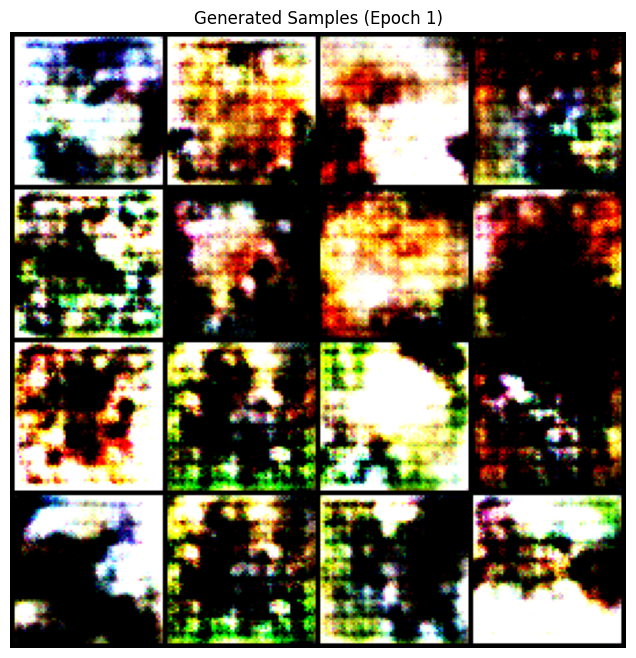

Epoch 2/250 completed in 38.51s


Epoch 3/250 completed in 38.74s


Epoch 4/250 completed in 38.91s


Epoch 5/250 completed in 39.05s


Epoch 6/250 completed in 39.00s


Epoch 7/250 completed in 39.20s


Epoch 8/250 completed in 39.19s


Epoch 9/250 completed in 40.82s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-6.5434093..6.3317504].


Epoch 10/250 completed in 42.38s


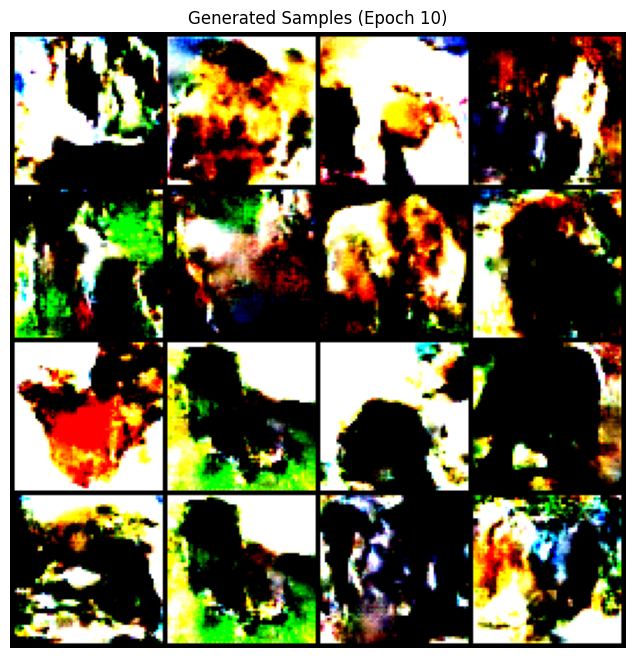

Epoch 11/250 completed in 38.33s


Epoch 12/250 completed in 38.36s


Epoch 13/250 completed in 38.08s


Epoch 14/250 completed in 42.02s


Epoch 15/250 completed in 41.65s


Epoch 16/250 completed in 38.55s


Epoch 17/250 completed in 38.18s


Epoch 18/250 completed in 38.47s


Epoch 19/250 completed in 38.49s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-5.227596..5.7956443].


Epoch 20/250 completed in 38.26s


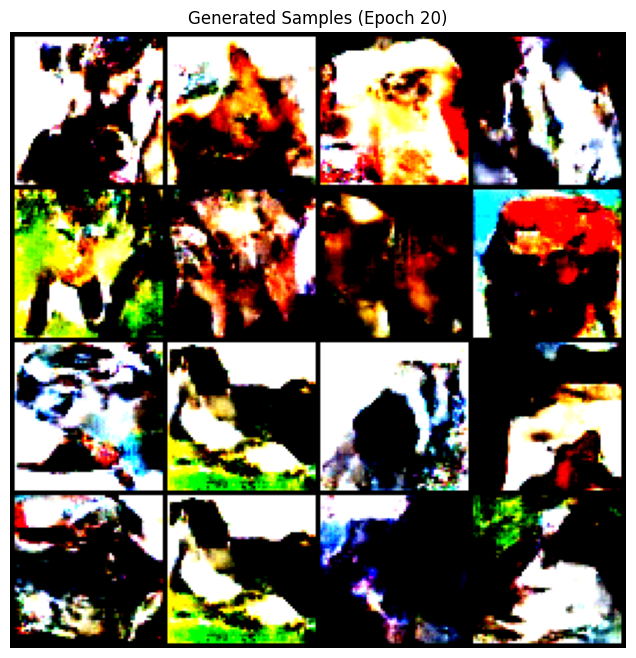

Epoch 21/250 completed in 41.05s


Epoch 22/250 completed in 39.01s


Epoch 23/250 completed in 38.96s


Epoch 24/250 completed in 39.62s


Epoch 25/250 completed in 39.56s


Epoch 26/250 completed in 40.01s


Epoch 27/250 completed in 39.76s


Epoch 28/250 completed in 39.39s


Epoch 29/250 completed in 39.27s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.5590882..4.204391].


Epoch 30/250 completed in 39.22s


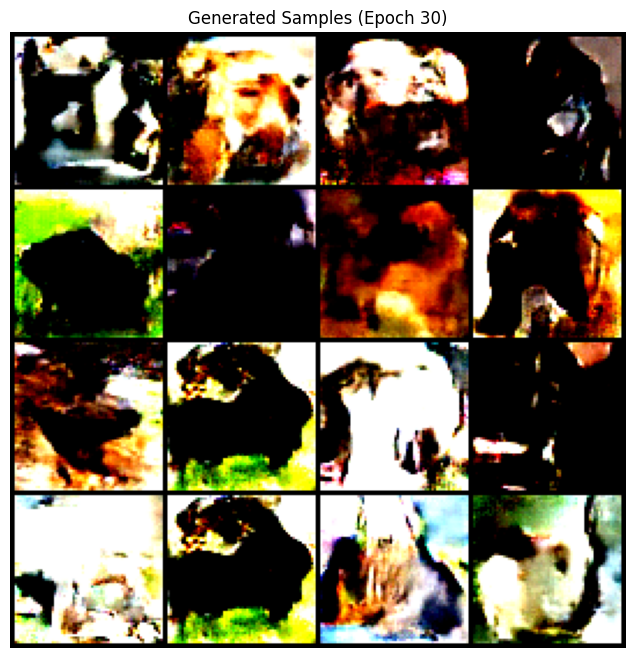

Epoch 31/250 completed in 39.65s


Epoch 32/250 completed in 40.09s


Epoch 33/250 completed in 40.88s


Epoch 34/250 completed in 38.84s


Epoch 35/250 completed in 39.00s


Epoch 36/250 completed in 38.66s


Epoch 37/250 completed in 41.33s


Epoch 38/250 completed in 41.68s


Epoch 39/250 completed in 40.64s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.5178497..4.594336].


Epoch 40/250 completed in 39.68s


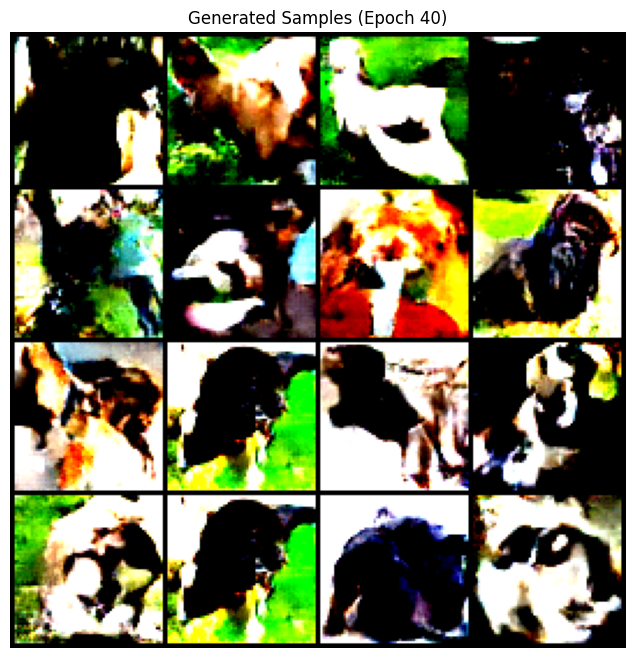

Epoch 41/250 completed in 39.11s


Epoch 42/250 completed in 39.32s


Epoch 43/250 completed in 40.09s


Epoch 44/250 completed in 44.52s


Epoch 45/250 completed in 39.44s


Epoch 46/250 completed in 39.34s


Epoch 47/250 completed in 39.31s


Epoch 48/250 completed in 39.46s


Epoch 49/250 completed in 39.40s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.624064..3.193283].


Epoch 50/250 completed in 39.43s


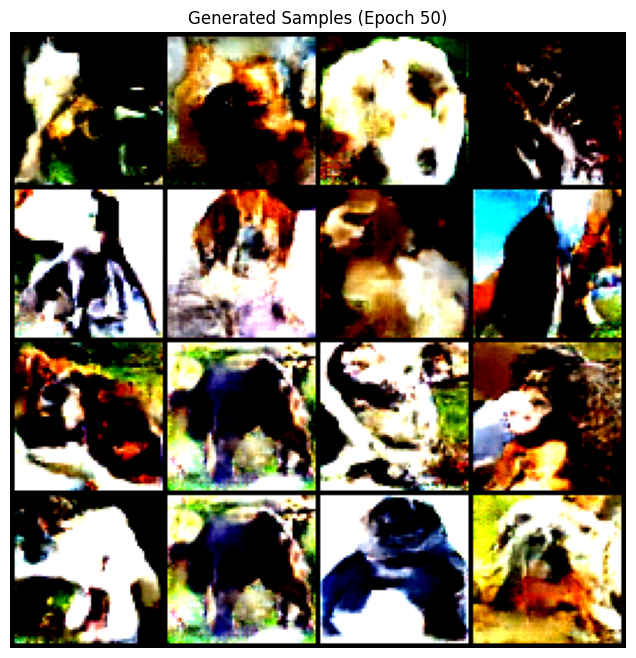

Epoch 51/250 completed in 39.45s


Epoch 52/250 completed in 39.40s


Epoch 53/250 completed in 39.31s


Epoch 54/250 completed in 39.28s


Epoch 55/250 completed in 39.55s


Epoch 56/250 completed in 39.85s


Epoch 57/250 completed in 39.33s


Epoch 58/250 completed in 39.43s


Epoch 59/250 completed in 39.15s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.2826087..3.4542599].


Epoch 60/250 completed in 39.46s


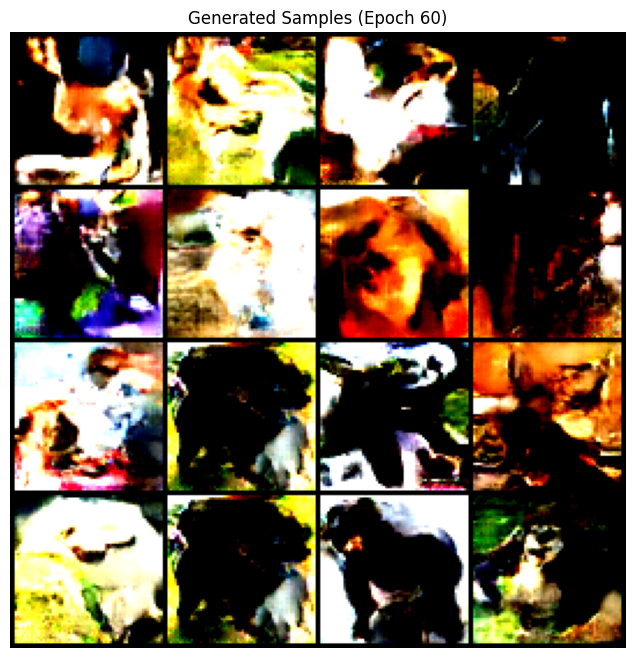

Epoch 61/250 completed in 39.21s


Epoch 62/250 completed in 43.78s


Epoch 63/250 completed in 43.07s


Epoch 64/250 completed in 39.26s


Epoch 65/250 completed in 39.62s


Epoch 66/250 completed in 40.88s


Epoch 67/250 completed in 42.44s


Epoch 68/250 completed in 43.43s


Epoch 69/250 completed in 44.87s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.5844636..3.5441556].


Epoch 70/250 completed in 45.01s


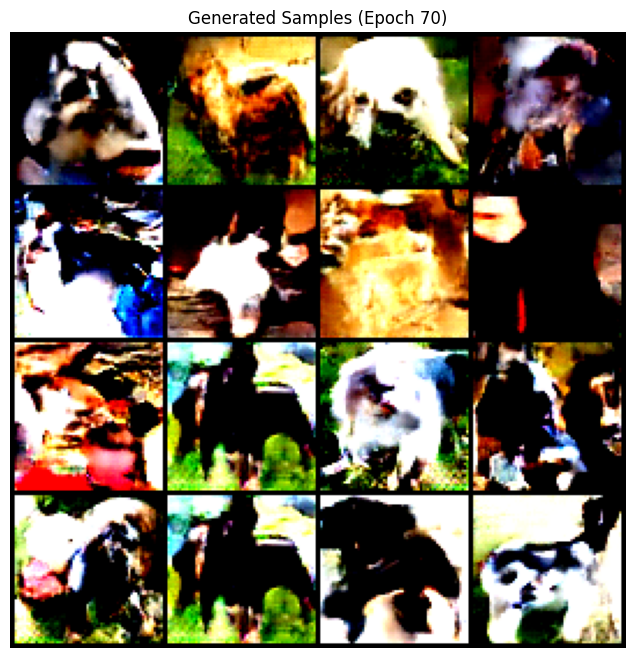

Epoch 71/250 completed in 44.76s


Epoch 72/250 completed in 43.75s


Epoch 73/250 completed in 44.98s


Epoch 74/250 completed in 49.08s


Epoch 75/250 completed in 49.66s


Epoch 76/250 completed in 52.37s


Epoch 77/250 completed in 56.44s


Epoch 78/250 completed in 56.99s


Epoch 79/250 completed in 55.88s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.156363..3.115265].


Epoch 80/250 completed in 58.50s


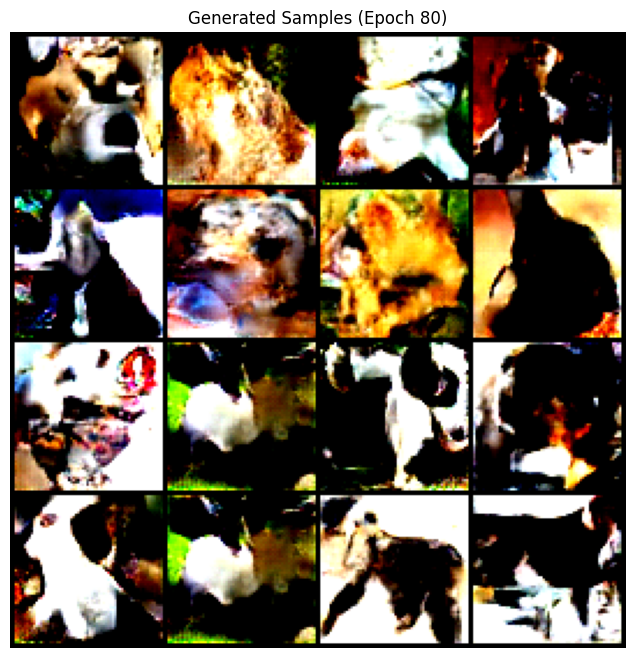

Epoch 81/250 completed in 52.56s


Epoch 82/250 completed in 50.41s


Epoch 83/250 completed in 53.75s


Epoch 84/250 completed in 58.25s


Epoch 85/250 completed in 57.86s


Epoch 86/250 completed in 55.13s


Epoch 87/250 completed in 46.55s


Epoch 88/250 completed in 42.44s


Epoch 89/250 completed in 42.34s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8697929..2.8486094].


Epoch 90/250 completed in 42.56s


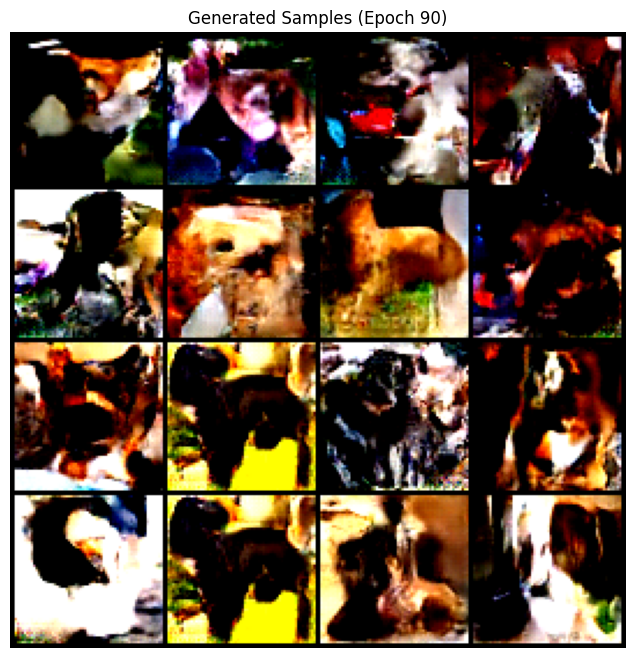

Epoch 91/250 completed in 43.09s


Epoch 92/250 completed in 42.52s


Epoch 93/250 completed in 43.63s


Epoch 94/250 completed in 43.05s


Epoch 95/250 completed in 43.03s


Epoch 96/250 completed in 42.94s


Epoch 97/250 completed in 42.48s


Epoch 98/250 completed in 42.58s


Epoch 99/250 completed in 42.46s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.1147829..2.7382662].


Epoch 100/250 completed in 42.93s


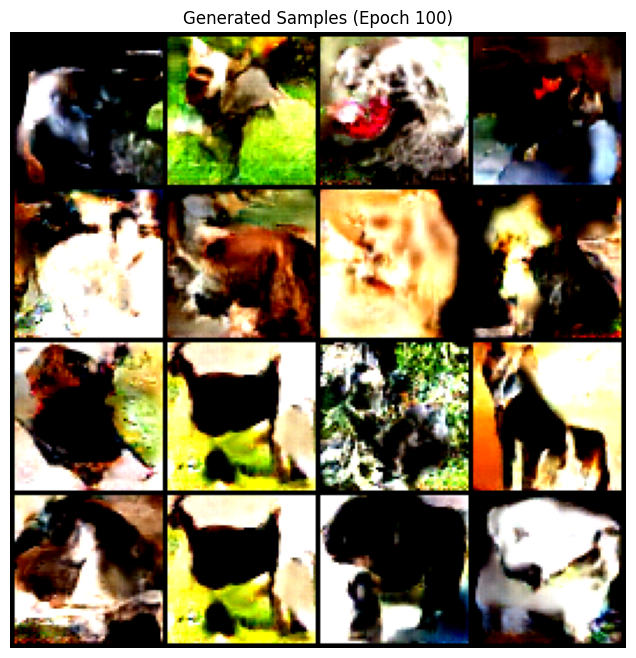

Epoch 101/250 completed in 42.92s


Epoch 102/250 completed in 46.76s


Epoch 103/250 completed in 45.62s


Epoch 104/250 completed in 45.27s


Epoch 105/250 completed in 45.07s


Epoch 106/250 completed in 42.57s


Epoch 107/250 completed in 42.63s


Epoch 108/250 completed in 42.62s


Epoch 109/250 completed in 42.44s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0806549..2.7450962].


Epoch 110/250 completed in 39.90s


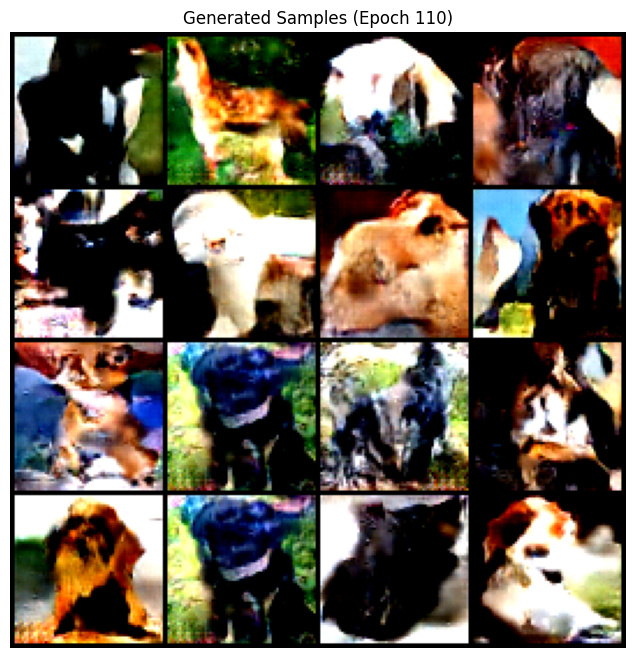

Epoch 111/250 completed in 40.58s


Epoch 112/250 completed in 40.84s


Epoch 113/250 completed in 40.77s


Epoch 114/250 completed in 41.15s


Epoch 115/250 completed in 40.76s


Epoch 116/250 completed in 41.29s


Epoch 117/250 completed in 41.12s


Epoch 118/250 completed in 40.93s


Epoch 119/250 completed in 42.96s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8773322..2.2946763].


Epoch 120/250 completed in 42.81s


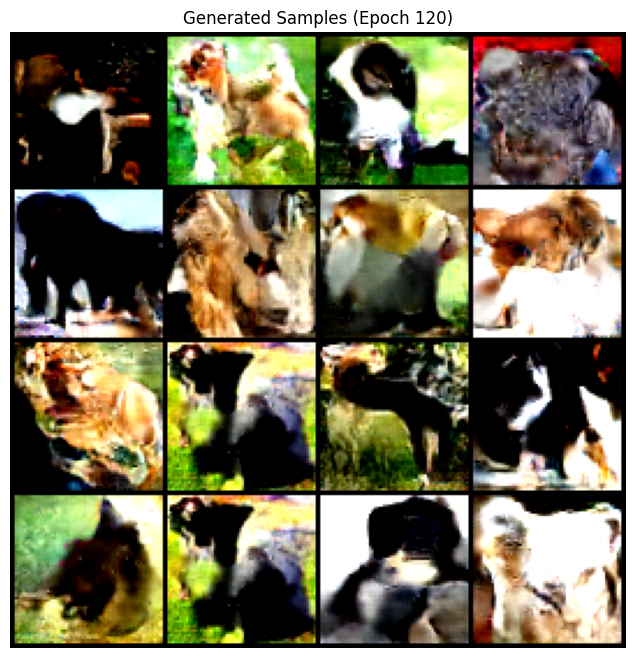

Epoch 121/250 completed in 43.87s


Epoch 122/250 completed in 41.19s


Epoch 123/250 completed in 40.85s


Epoch 124/250 completed in 39.49s


Epoch 125/250 completed in 39.63s


Epoch 126/250 completed in 39.76s


Epoch 127/250 completed in 39.27s


Epoch 128/250 completed in 39.56s


Epoch 129/250 completed in 40.79s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9691223..1.8613844].


Epoch 130/250 completed in 40.32s


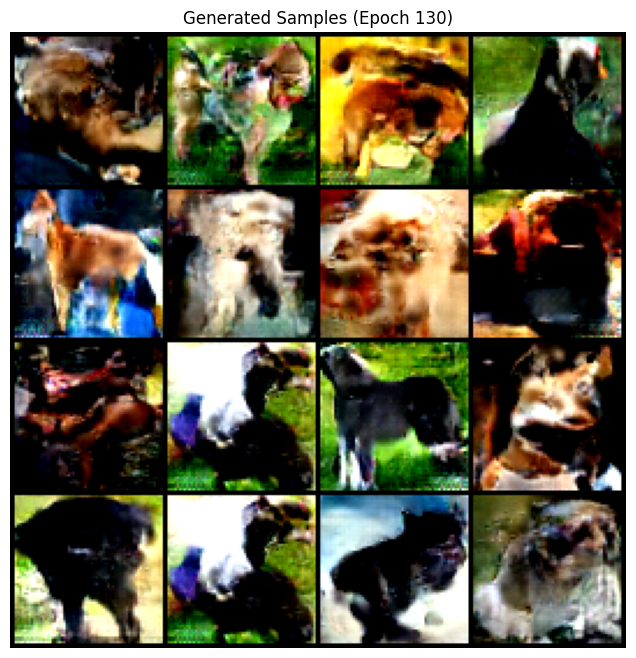

Epoch 131/250 completed in 40.75s


Epoch 132/250 completed in 40.57s


Epoch 133/250 completed in 40.26s


Epoch 134/250 completed in 39.61s


Epoch 135/250 completed in 40.98s


Epoch 136/250 completed in 39.67s


Epoch 137/250 completed in 39.64s


Epoch 138/250 completed in 41.50s


Epoch 139/250 completed in 39.56s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.75347364..1.6694536].


Epoch 140/250 completed in 40.91s


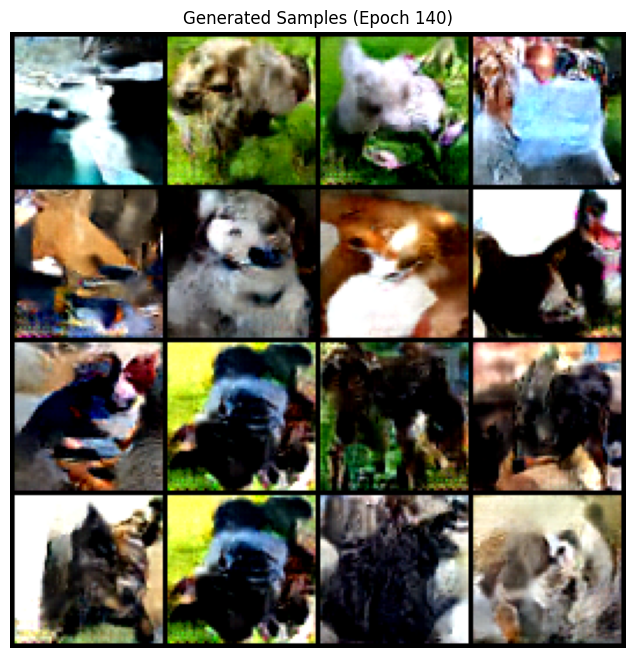

Epoch 141/250 completed in 42.80s


Epoch 142/250 completed in 43.16s


Epoch 143/250 completed in 39.84s


Epoch 144/250 completed in 40.22s


Epoch 145/250 completed in 39.96s


Epoch 146/250 completed in 42.33s


Epoch 147/250 completed in 40.44s


Epoch 148/250 completed in 39.57s


Epoch 149/250 completed in 39.35s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.98171175..1.7237351].


Epoch 150/250 completed in 39.41s


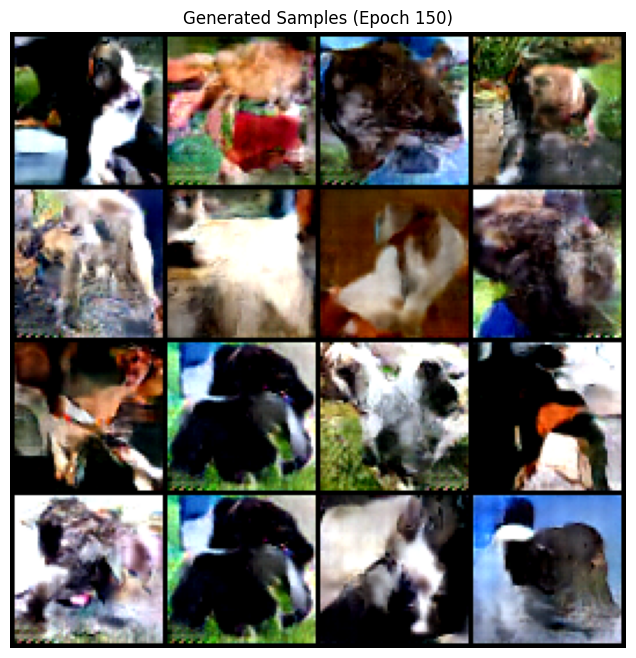

Epoch 151/250 completed in 39.79s


Epoch 152/250 completed in 39.78s


Epoch 153/250 completed in 39.69s


Epoch 154/250 completed in 39.61s


Epoch 155/250 completed in 42.26s


Epoch 156/250 completed in 40.20s


Epoch 157/250 completed in 40.32s


Epoch 158/250 completed in 40.49s


Epoch 159/250 completed in 40.77s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.76850736..1.8604325].


Epoch 160/250 completed in 40.66s


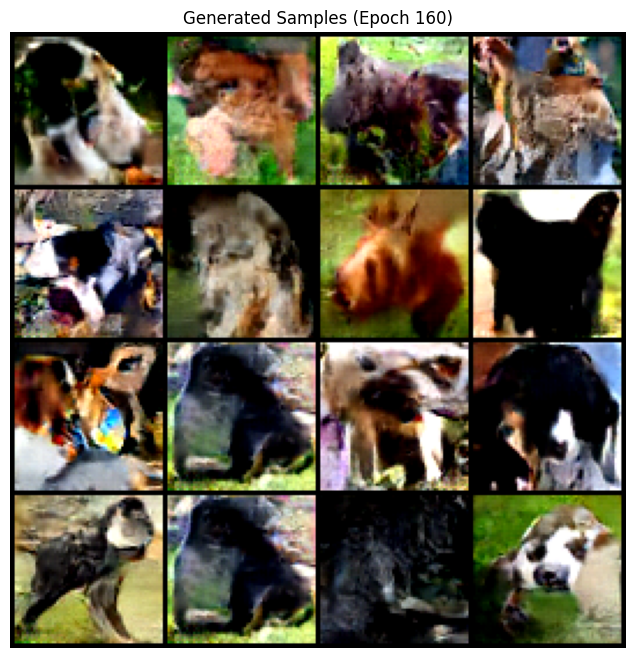

Epoch 161/250 completed in 40.62s


Epoch 162/250 completed in 41.46s


Epoch 163/250 completed in 42.01s


Epoch 164/250 completed in 43.29s


Epoch 165/250 completed in 43.26s


Epoch 166/250 completed in 43.40s


Epoch 167/250 completed in 43.15s


Epoch 168/250 completed in 43.21s


Epoch 169/250 completed in 43.40s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.81243145..1.788567].


Epoch 170/250 completed in 43.33s


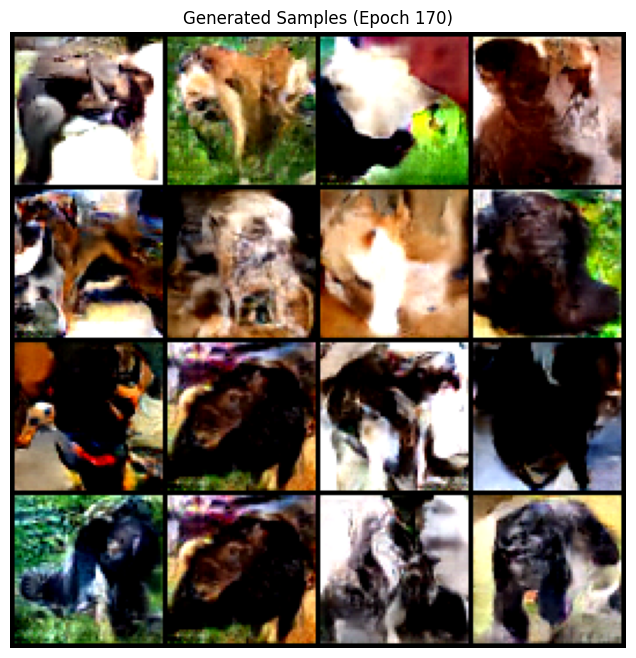

Epoch 171/250 completed in 42.75s


Epoch 172/250 completed in 42.59s


Epoch 173/250 completed in 42.38s


Epoch 174/250 completed in 42.50s


Epoch 175/250 completed in 42.47s


Epoch 176/250 completed in 42.74s


Epoch 177/250 completed in 42.58s


Epoch 178/250 completed in 39.93s


Epoch 179/250 completed in 40.04s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.7601236..1.6440231].


Epoch 180/250 completed in 39.77s


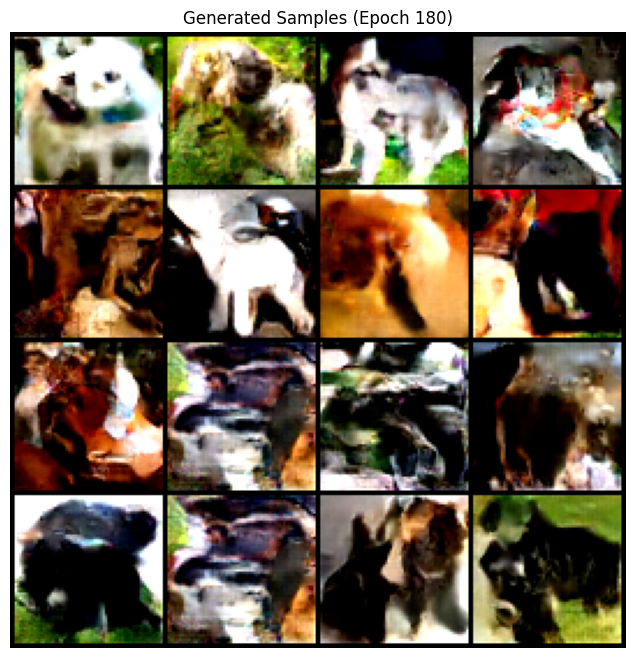

Epoch 181/250 completed in 39.90s


Epoch 182/250 completed in 39.75s


Epoch 183/250 completed in 39.94s


Epoch 184/250 completed in 39.61s


Epoch 185/250 completed in 39.91s


Epoch 186/250 completed in 39.81s


Epoch 187/250 completed in 39.97s


Epoch 188/250 completed in 39.86s


Epoch 189/250 completed in 40.62s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.568125..1.4953802].


Epoch 190/250 completed in 39.70s


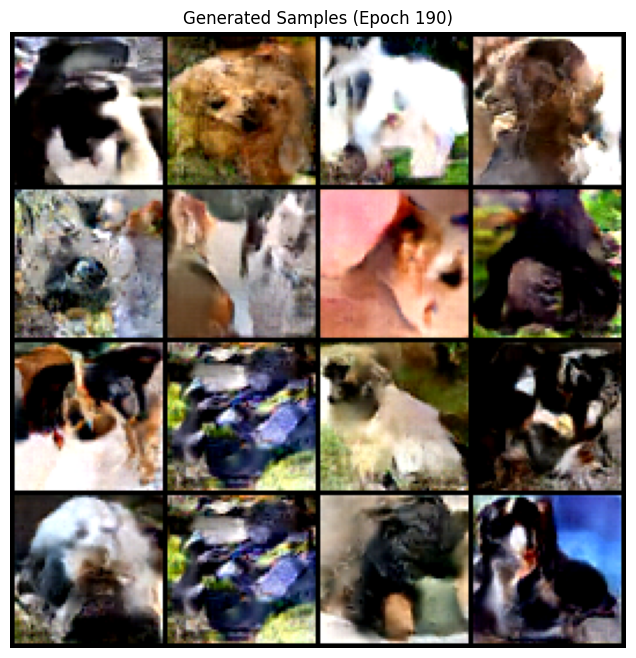

Epoch 191/250 completed in 41.22s


Epoch 192/250 completed in 41.67s


Epoch 193/250 completed in 40.58s


Epoch 194/250 completed in 40.87s


Epoch 195/250 completed in 40.90s


Epoch 196/250 completed in 41.04s


Epoch 197/250 completed in 40.43s


Epoch 198/250 completed in 40.36s


Epoch 199/250 completed in 40.23s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.54904425..1.5385942].


Epoch 200/250 completed in 40.01s


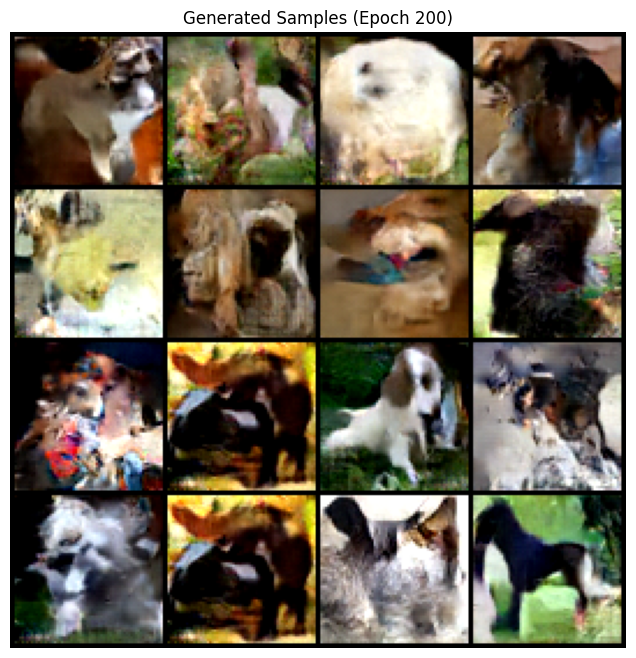

Epoch 201/250 completed in 40.24s


Epoch 202/250 completed in 41.01s


Epoch 203/250 completed in 41.56s


Epoch 204/250 completed in 41.06s


Epoch 205/250 completed in 40.60s


Epoch 206/250 completed in 40.47s


Epoch 207/250 completed in 40.62s


Epoch 208/250 completed in 40.62s


Epoch 209/250 completed in 40.61s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.2749644..1.6376984].


Epoch 210/250 completed in 41.13s


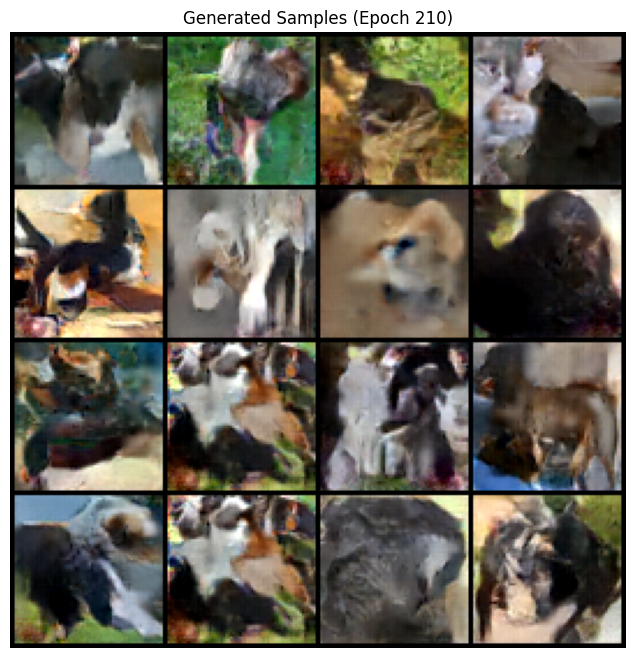

Epoch 211/250 completed in 40.71s


Epoch 212/250 completed in 40.06s


Epoch 213/250 completed in 39.99s


Epoch 214/250 completed in 40.23s


Epoch 215/250 completed in 39.98s


Epoch 216/250 completed in 40.19s


Epoch 217/250 completed in 40.20s


Epoch 218/250 completed in 40.15s


Epoch 219/250 completed in 39.99s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.16384679..1.1582733].


Epoch 220/250 completed in 39.90s


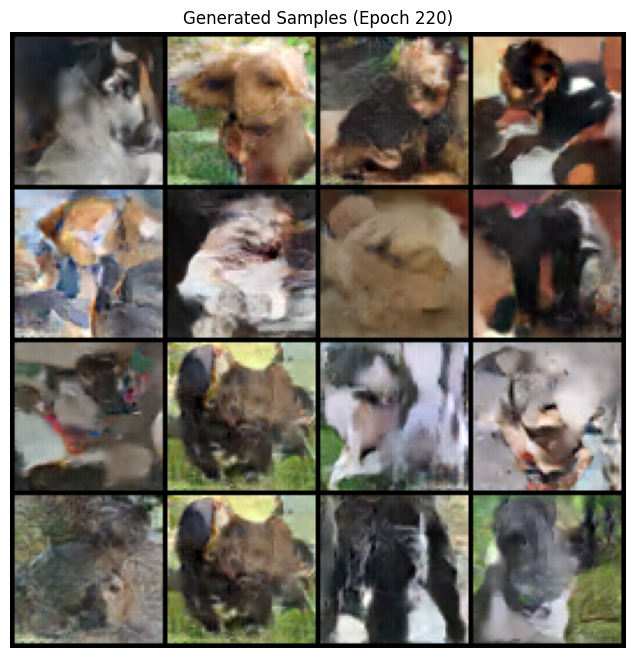

Epoch 221/250 completed in 40.76s


Epoch 222/250 completed in 41.70s


Epoch 223/250 completed in 41.51s


Epoch 224/250 completed in 41.56s


Epoch 225/250 completed in 40.71s


Epoch 226/250 completed in 42.63s


Epoch 227/250 completed in 42.99s


Epoch 228/250 completed in 40.09s


Epoch 229/250 completed in 40.52s


Epoch 230/250 completed in 44.01s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.10245961..1.3069844].


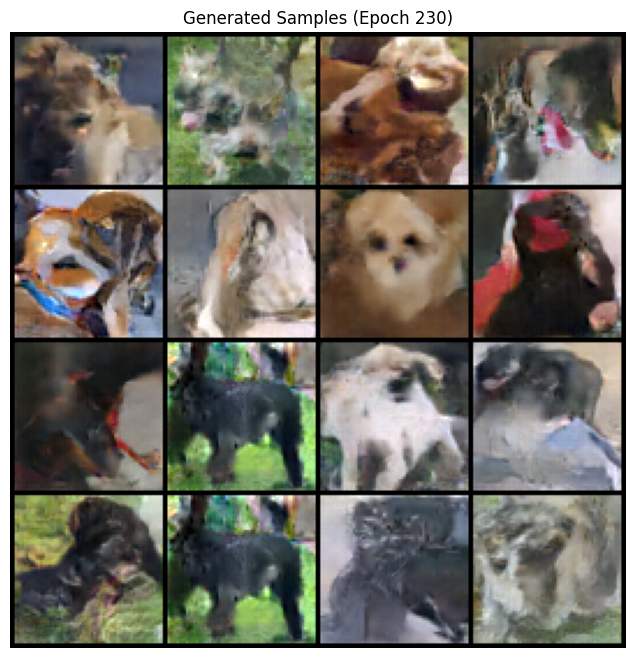

Epoch 231/250 completed in 44.30s


Epoch 232/250 completed in 43.82s


Epoch 233/250 completed in 43.88s


Epoch 234/250 completed in 43.82s


Epoch 235/250 completed in 44.02s


Epoch 236/250 completed in 43.65s


Epoch 237/250 completed in 43.97s


Epoch 238/250 completed in 43.94s


Epoch 239/250 completed in 43.79s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2184823].


Epoch 240/250 completed in 43.61s


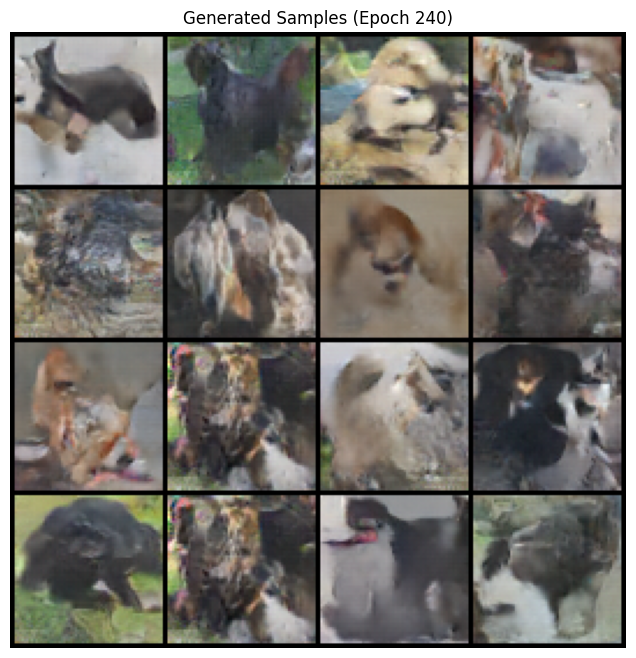

Epoch 241/250 completed in 43.91s


Epoch 242/250 completed in 43.74s


Epoch 243/250 completed in 44.01s


Epoch 244/250 completed in 44.27s


Epoch 245/250 completed in 44.77s


Epoch 246/250 completed in 44.87s


Epoch 247/250 completed in 44.09s


Epoch 248/250 completed in 40.90s


Epoch 249/250 completed in 40.32s


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.060940504..1.2242147].


Epoch 250/250 completed in 40.03s


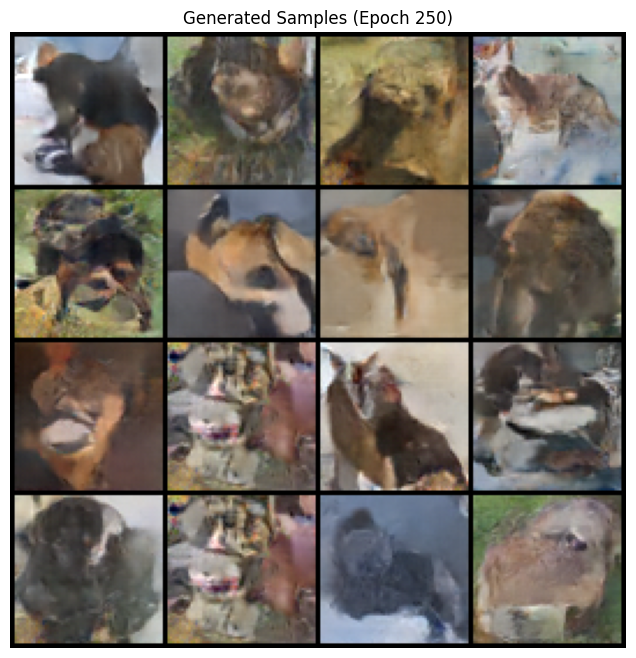

In [11]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
generator = Generator(noise_dim=100, num_classes=len(dataset.class_names))
discriminator = Discriminator(num_classes=len(dataset.class_names))

train_cgan(generator, discriminator, dataloader, num_epochs=250, noise_dim=100, num_classes=len(dataset.class_names), device=device)


In [12]:
def show_generated_vs_real(generator, dataset, noise_dim=100, num_samples=5, device='cuda'):
    generator.eval()
    real_images = []
    fake_images = []
    labels = []

    for _ in range(num_samples):
        # Выбор случайного примера из датасета
        idx = random.randint(0, len(dataset) - 1)
        img_path, _, label = dataset.samples[idx]
        image = Image.open(img_path).convert('RGB')
        image = image.crop(dataset.samples[idx][1])
        image = TF.resize(image, (64, 64))
        image = TF.to_tensor(image)
        image = image * 0.5 + 0.5  # возвращаем к [0, 1] для отображения
        real_images.append(image)
        labels.append(label)

    # Генерация фейковых изображений
    z = torch.randn(num_samples, noise_dim, device=device)
    labels_tensor = torch.tensor(labels, device=device)
    with torch.no_grad():
        gen_imgs = generator(z, labels_tensor).cpu()
        gen_imgs = gen_imgs * 0.5 + 0.5  # Обратно из [-1,1] в [0,1]

    fake_images = gen_imgs

    # Визуализация
    fig, axs = plt.subplots(num_samples, 2, figsize=(6, num_samples * 3))
    for i in range(num_samples):
        axs[i, 0].imshow(real_images[i].permute(1, 2, 0))
        axs[i, 0].set_title(f"Real - {dataset.class_names[labels[i]]}")
        axs[i, 0].axis("off")

        axs[i, 1].imshow(fake_images[i].permute(1, 2, 0))
        axs[i, 1].set_title(f"Generated")
        axs[i, 1].axis("off")

    plt.tight_layout()
    plt.show()

    generator.train()


мы написали функцию которая будет генерить и можем попытаться глянуть результат

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0119639635..1.0351067].


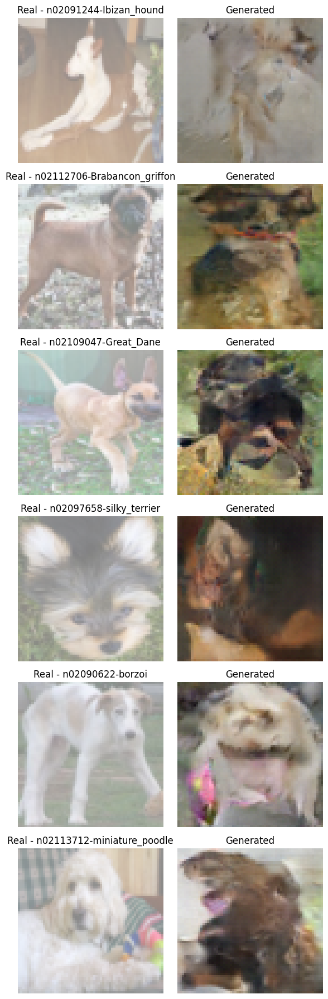

In [19]:
show_generated_vs_real(generator, dataset, noise_dim=100, num_samples=6, device=device)

страшно очень страшно, до чего доведет нас генная инженерия но, сохраним модели

In [1]:
torch.save(generator.state_dict(), "generator256.pt")
torch.save(discriminator.state_dict(), "discriminator256.pt")

NameError: name 'torch' is not defined

In [21]:
generator = Generator(noise_dim=100, num_classes=len(dataset.class_names))
discriminator = Discriminator(num_classes=len(dataset.class_names))

generator.load_state_dict(torch.load("generator.pt"))
discriminator.load_state_dict(torch.load("discriminator.pt"))

generator.to(device)
discriminator.to(device)

generator.eval()

Generator(
  (label_emb): Embedding(120, 120)
  (project): Linear(in_features=220, out_features=16384, bias=True)
  (upsample): Sequential(
    (0): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(128, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (7): Tanh()
  )
  (cbn1): ConditionalBatchNorm2d(
    (bn): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=False, track_running_stats=True)
    (gamma): Embedding(120, 512)
    (beta): Embedding(120, 512)
  )
  (cbn2): ConditionalBatchNorm2d(
    (bn): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=True)
    (gamma): Embedding(120, 256)
    (beta): Embedding(120, 256)
  )
  (cbn3): ConditionalBa

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.10249382..1.157594].


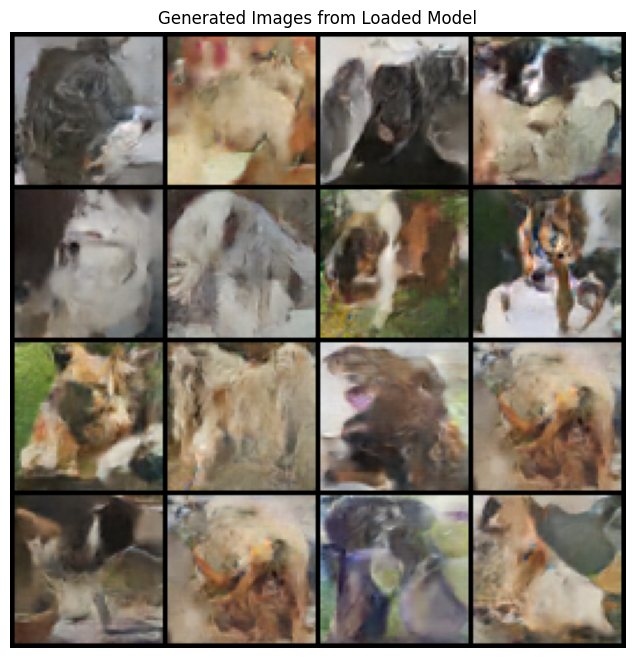

In [41]:
z = torch.randn(16, 100, device=device)
labels = torch.randint(0, len(dataset.class_names), (16,), device=device)

with torch.no_grad():
    gen_imgs = generator(z, labels) * 0.5 + 0.5

grid = make_grid(gen_imgs.cpu(), nrow=4)
plt.figure(figsize=(8, 8))
plt.imshow(grid.permute(1, 2, 0))
plt.axis("off")
plt.title("Generated Images from Loaded Model")
plt.show()


далее генератори дискриминатор для 256х256 модели, и процесс обучения, он заврешился ночью и произошел разрыв с ноутбуком поэтому код обучения довыполнялся но сами модели не сохранились, но мы можем пронаблюдать процесс обучения

In [48]:
class Generator256(nn.Module):
    def __init__(self, noise_dim=100, num_classes=120):
        super().__init__()
        self.label_emb = nn.Embedding(num_classes, num_classes)
        self.project = nn.Linear(noise_dim + num_classes, 1024 * 4 * 4)

        self.upsample = nn.Sequential(
            nn.ConvTranspose2d(1024, 512, 4, 2, 1),  # 8x8
            nn.BatchNorm2d(512),
            nn.ReLU(True),

            nn.ConvTranspose2d(512, 256, 4, 2, 1),  # 16x16
            nn.BatchNorm2d(256),
            nn.ReLU(True),

            nn.ConvTranspose2d(256, 128, 4, 2, 1),  # 32x32
            nn.BatchNorm2d(128),
            nn.ReLU(True),

            nn.ConvTranspose2d(128, 64, 4, 2, 1),   # 64x64
            nn.BatchNorm2d(64),
            nn.ReLU(True),

            nn.ConvTranspose2d(64, 32, 4, 2, 1),    # 128x128
            nn.BatchNorm2d(32),
            nn.ReLU(True),

            nn.ConvTranspose2d(32, 3, 4, 2, 1),     # 256x256
            nn.Tanh()
        )

    def forward(self, z, labels):
        emb = self.label_emb(labels)
        x = torch.cat([z, emb], dim=1)
        x = self.project(x).view(-1, 1024, 4, 4)
        return self.upsample(x)


In [49]:
class Discriminator256(nn.Module):
    def __init__(self, num_classes=120):
        super().__init__()

        def block(in_c, out_c):
            return nn.Sequential(
                nn.Conv2d(in_c, out_c, 4, 2, 1),
                nn.BatchNorm2d(out_c),
                nn.LeakyReLU(0.2, inplace=True)
            )

        self.conv = nn.Sequential(
            block(3, 32),     # 128x128
            block(32, 64),    # 64x64
            block(64, 128),   # 32x32
            block(128, 256),  # 16x16
            block(256, 512),  # 8x8
            block(512, 1024), # 4x4
        )

        self.real_fake = nn.Sequential(
            nn.Conv2d(1024, 1, 4), 
            nn.Sigmoid()
        )

        self.classifier = nn.Sequential(
            nn.Flatten(),
            nn.Linear(1024 * 4 * 4, num_classes)
        )

    def forward(self, x):
        features = self.conv(x)
        rf = self.real_fake(features).view(-1)
        cls = self.classifier(features)
        return rf, cls


Epoch 1/200 completed in 108.40s


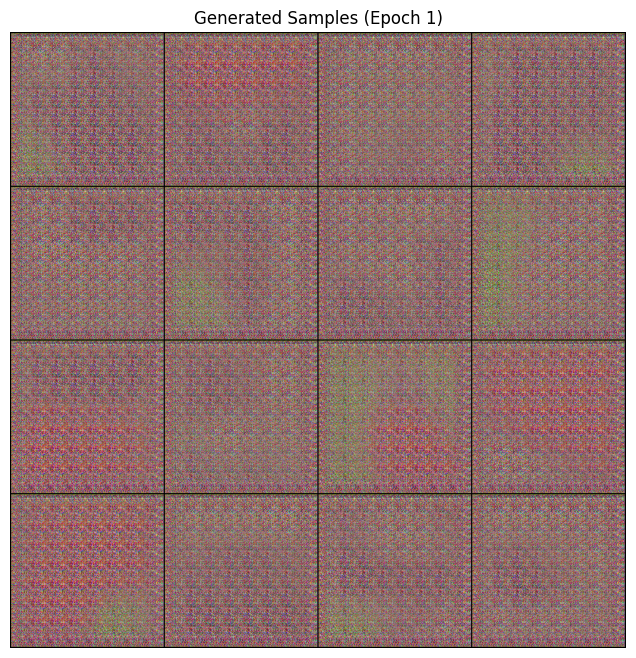

Epoch 2/200 completed in 111.88s


Epoch 3/200 completed in 111.15s


Epoch 4/200 completed in 113.94s


Epoch 5/200 completed in 112.29s


Epoch 6/200 completed in 111.79s


Epoch 7/200 completed in 110.66s


Epoch 8/200 completed in 111.52s


Epoch 9/200 completed in 108.25s


Epoch 10/200 completed in 110.55s


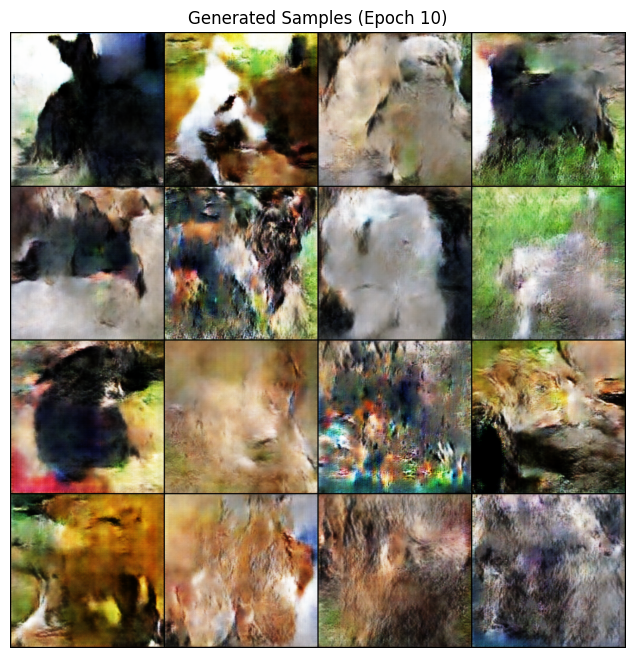

Epoch 11/200 completed in 109.85s


Epoch 12/200 completed in 109.55s


Epoch 13/200 completed in 109.19s


Epoch 14/200 completed in 109.78s


Epoch 15/200 completed in 111.06s


Epoch 16/200 completed in 108.38s


Epoch 17/200 completed in 109.14s


Epoch 18/200 completed in 110.29s


Epoch 19/200 completed in 109.89s


Epoch 20/200 completed in 111.74s


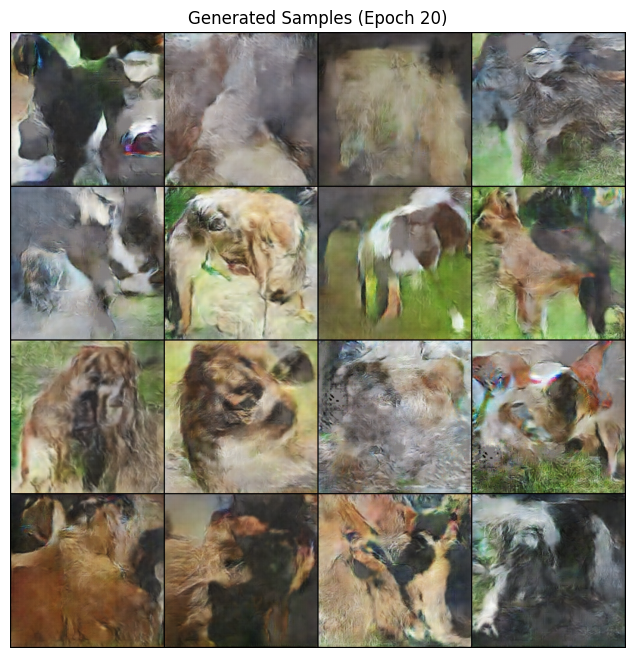

Epoch 21/200 completed in 111.04s


Epoch 22/200 completed in 109.69s


Epoch 23/200 completed in 110.79s


Epoch 24/200 completed in 112.99s


Epoch 25/200 completed in 111.43s


Epoch 26/200 completed in 110.79s


Epoch 27/200 completed in 108.51s


Epoch 28/200 completed in 111.33s


Epoch 29/200 completed in 111.13s


Epoch 30/200 completed in 111.57s


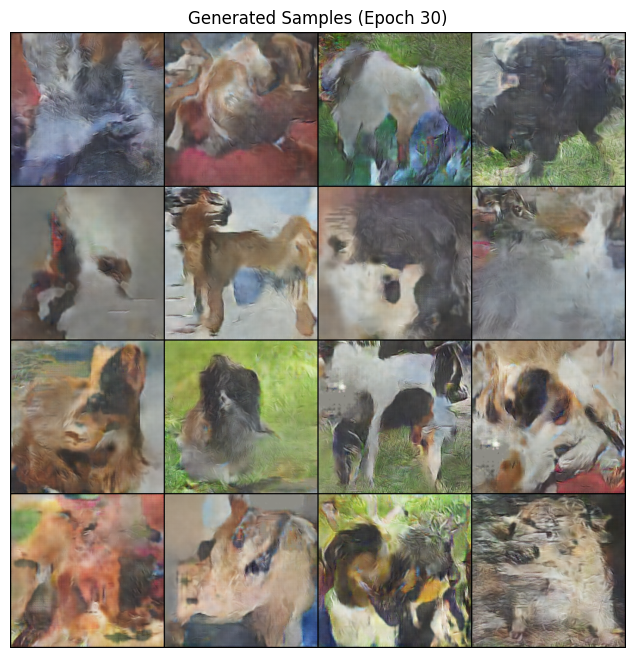

Epoch 31/200 completed in 114.18s


Epoch 32/200 completed in 114.53s


Epoch 33/200 completed in 113.11s


Epoch 34/200 completed in 108.91s


Epoch 35/200 completed in 115.88s


Epoch 36/200 completed in 111.35s


Epoch 37/200 completed in 112.31s


Epoch 38/200 completed in 110.40s


Epoch 39/200 completed in 111.95s


Epoch 40/200 completed in 111.94s


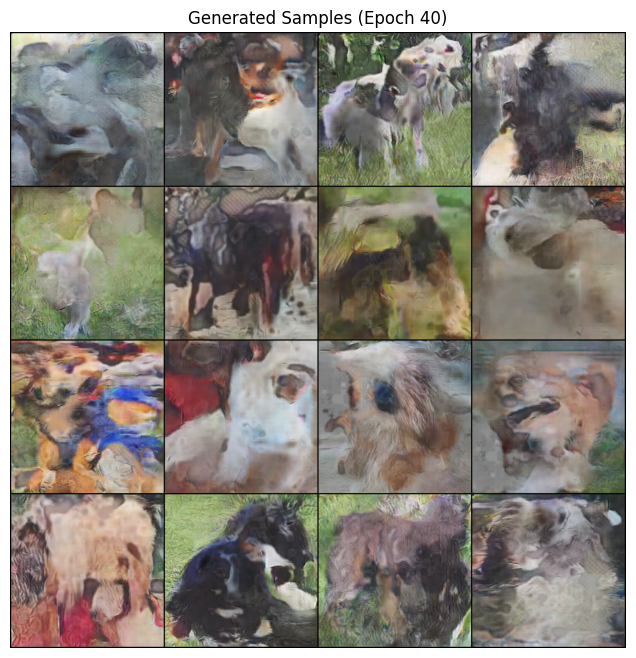

Epoch 41/200 completed in 114.50s


Epoch 42/200 completed in 115.31s


Epoch 43/200 completed in 109.76s


Epoch 44/200 completed in 114.64s


Epoch 45/200 completed in 110.98s


Epoch 46/200 completed in 111.71s


Epoch 47/200 completed in 115.42s


Epoch 48/200 completed in 117.02s


Epoch 49/200 completed in 109.15s


Epoch 50/200 completed in 116.53s


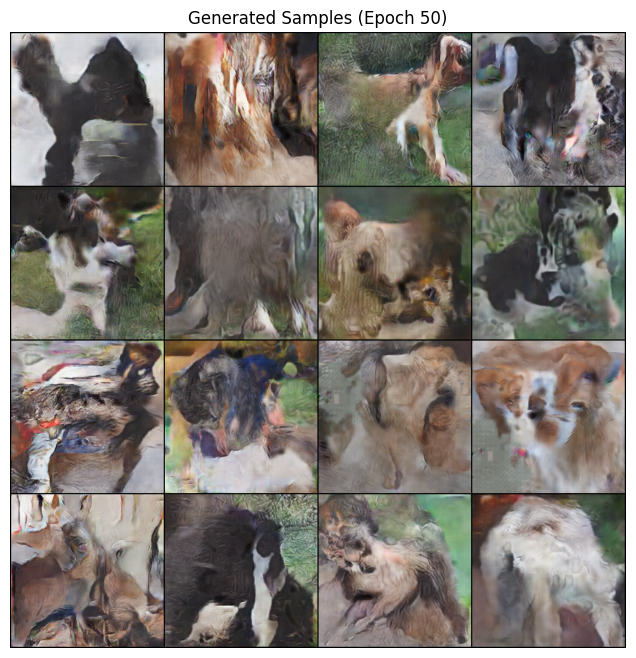

Epoch 51/200 completed in 115.65s


Epoch 52/200 completed in 116.64s


Epoch 53/200 completed in 110.00s


Epoch 54/200 completed in 116.90s


Epoch 55/200 completed in 116.65s


Epoch 56/200 completed in 119.14s


Epoch 57/200 completed in 115.68s


Epoch 58/200 completed in 114.92s


Epoch 59/200 completed in 111.58s


Epoch 60/200 completed in 119.03s


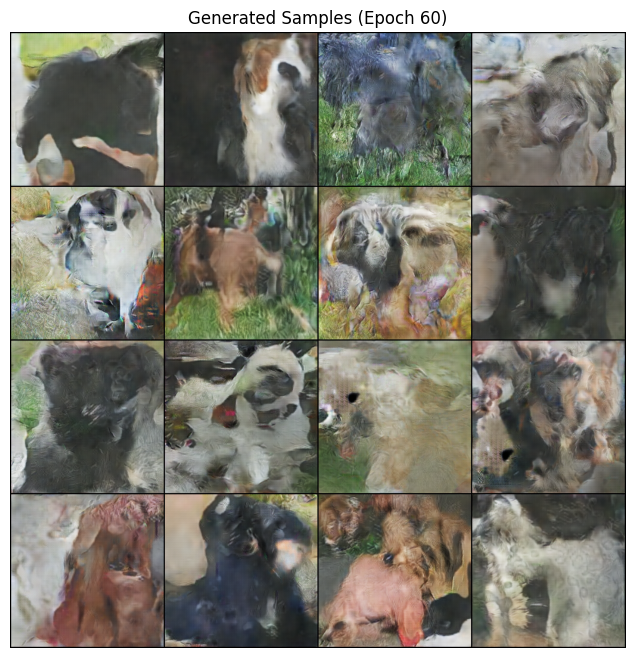

Epoch 61/200 completed in 115.98s


Epoch 62/200 completed in 116.81s


Epoch 63/200 completed in 116.14s


Epoch 64/200 completed in 117.08s


Epoch 65/200 completed in 111.82s


Epoch 66/200 completed in 116.34s


Epoch 67/200 completed in 114.12s


Epoch 68/200 completed in 111.02s


Epoch 69/200 completed in 113.94s


Epoch 70/200 completed in 111.35s


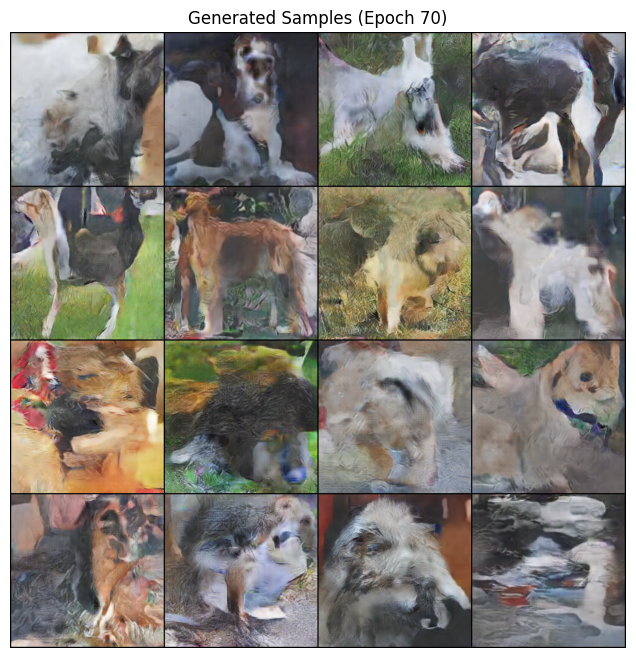

Epoch 71/200 completed in 117.65s


Epoch 72/200 completed in 118.14s


Epoch 73/200 completed in 115.72s


Epoch 74/200 completed in 114.66s


Epoch 75/200 completed in 118.20s


Epoch 76/200 completed in 117.90s


Epoch 77/200 completed in 121.27s


Epoch 78/200 completed in 115.03s


Epoch 79/200 completed in 116.92s


Epoch 80/200 completed in 116.22s


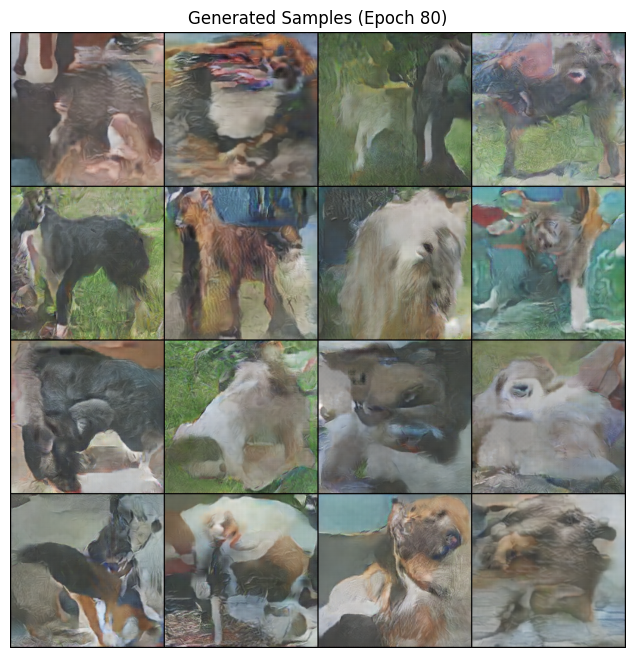

Epoch 81/200 completed in 119.45s


Epoch 82/200 completed in 117.85s


Epoch 83/200 completed in 119.34s


Epoch 84/200 completed in 115.15s


Epoch 85/200 completed in 113.73s


Epoch 86/200 completed in 113.61s


Epoch 87/200 completed in 119.30s


Epoch 88/200 completed in 113.67s


Epoch 89/200 completed in 119.28s


Epoch 90/200 completed in 112.99s


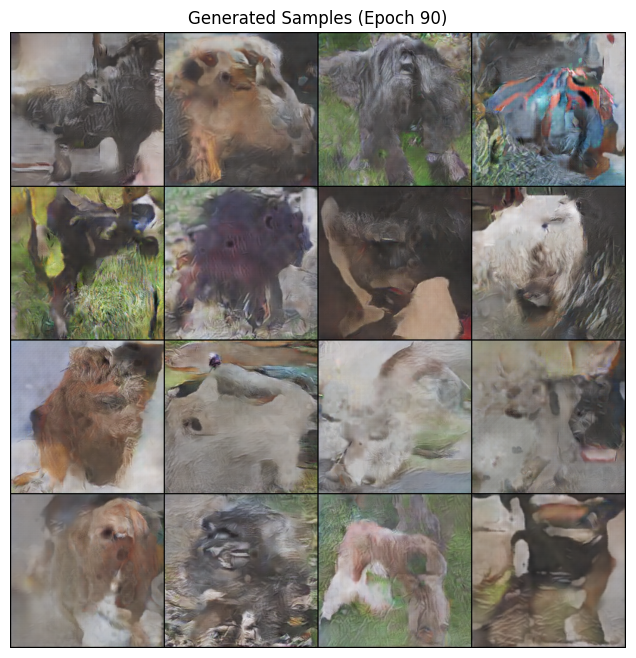

Epoch 91/200 completed in 116.38s


Epoch 92/200 completed in 116.00s


Epoch 93/200 completed in 121.46s


Epoch 94/200 completed in 120.61s


Epoch 95/200 completed in 115.27s


Epoch 96/200 completed in 116.58s


Epoch 97/200 completed in 121.14s


Epoch 98/200 completed in 117.54s


Epoch 99/200 completed in 117.33s


Epoch 100/200 completed in 115.33s


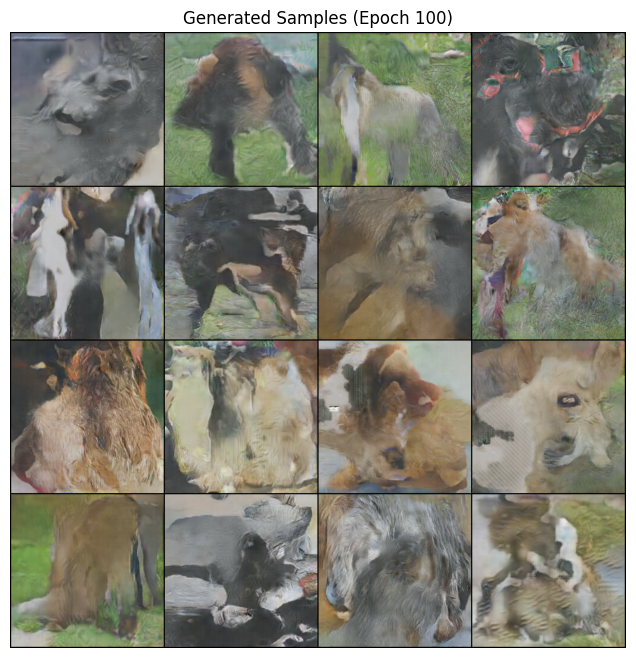

Epoch 101/200 completed in 119.10s


Epoch 102/200 completed in 114.21s


Epoch 103/200 completed in 119.99s


Epoch 104/200 completed in 120.56s


Epoch 105/200 completed in 117.32s


Epoch 106/200 completed in 119.19s


Epoch 107/200 completed in 124.21s


Epoch 108/200 completed in 119.45s


Epoch 109/200 completed in 119.52s


Epoch 110/200 completed in 118.21s


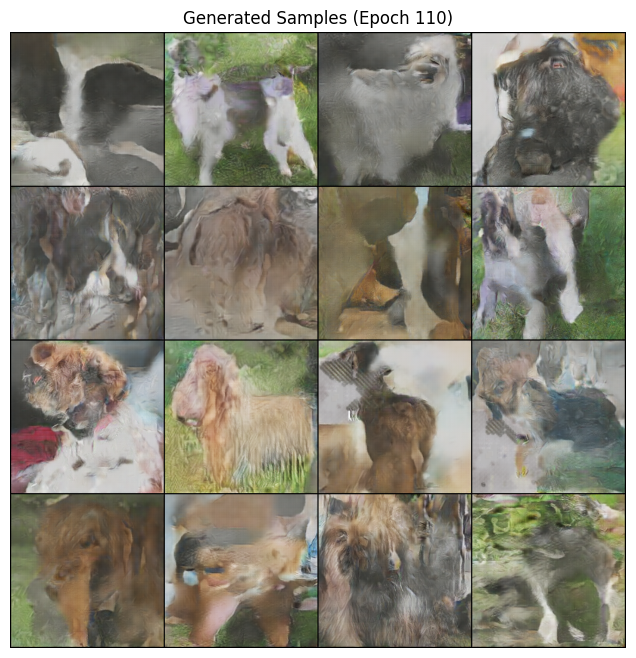

Epoch 111/200 completed in 121.52s


Epoch 112/200 completed in 116.92s


Epoch 113/200 completed in 128.83s


Epoch 114/200 completed in 119.00s


Epoch 115/200 completed in 120.55s


Epoch 116/200 completed in 120.04s


Epoch 117/200 completed in 121.01s


Epoch 118/200 completed in 118.12s


Epoch 119/200 completed in 119.76s


Epoch 120/200 completed in 119.25s


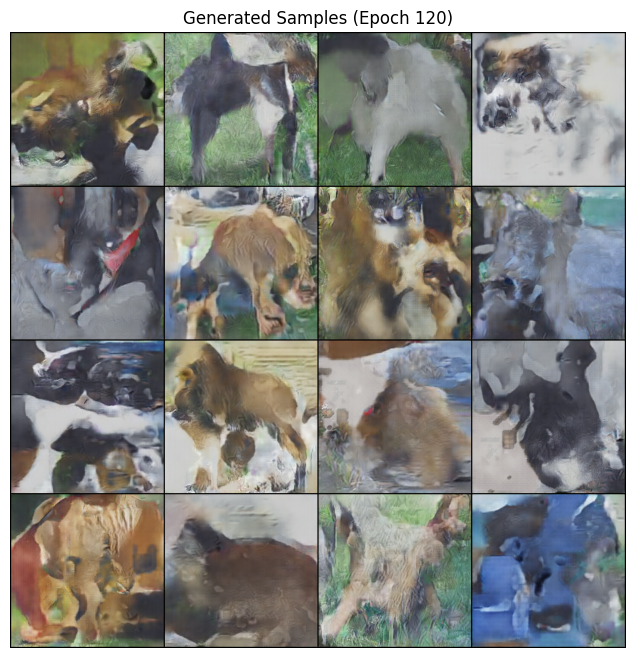

Epoch 121/200 completed in 120.84s


Epoch 122/200 completed in 117.33s


Epoch 123/200 completed in 119.35s


Epoch 124/200 completed in 116.40s


Epoch 125/200 completed in 119.48s


Epoch 126/200 completed in 121.37s


Epoch 127/200 completed in 122.55s


Epoch 128/200 completed in 119.12s


Epoch 129/200 completed in 116.28s


Epoch 130/200 completed in 117.65s


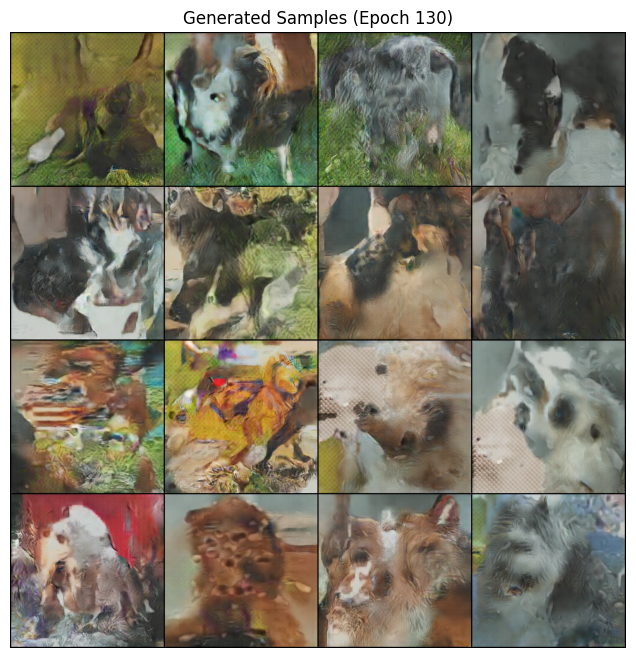

Epoch 131/200 completed in 118.25s


Epoch 132/200 completed in 118.49s


Epoch 133/200 completed in 115.99s


Epoch 134/200 completed in 119.61s


Epoch 135/200 completed in 118.49s


Epoch 136/200 completed in 120.44s


Epoch 137/200 completed in 117.80s


Epoch 138/200 completed in 115.14s


Epoch 139/200 completed in 118.42s


Epoch 140/200 completed in 123.36s


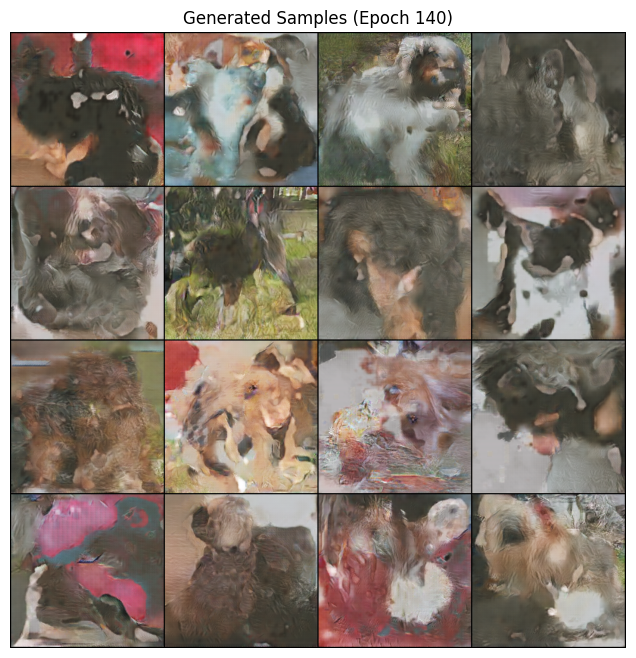

Epoch 141/200 completed in 117.59s


Epoch 142/200 completed in 124.28s


Epoch 143/200 completed in 121.39s


Epoch 144/200 completed in 117.79s


Epoch 145/200 completed in 124.28s


Epoch 146/200 completed in 123.16s


Epoch 147/200 completed in 123.07s


Epoch 148/200 completed in 121.57s


Epoch 149/200 completed in 114.65s


Epoch 150/200 completed in 122.70s


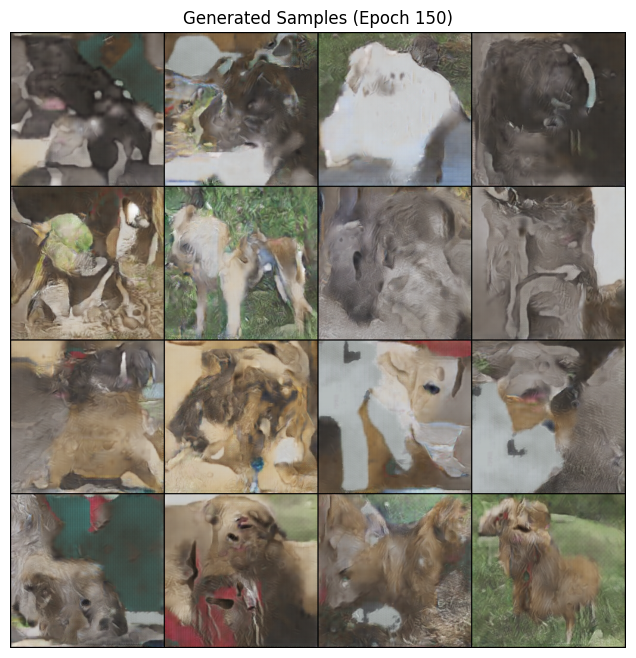

Epoch 151/200 completed in 119.05s


Epoch 152/200 completed in 121.00s


Epoch 153/200 completed in 118.13s


Epoch 154/200 completed in 124.75s


Epoch 155/200 completed in 122.86s


Epoch 156/200 completed in 121.03s


Epoch 157/200 completed in 117.23s


Epoch 158/200 completed in 118.36s


Epoch 159/200 completed in 121.41s


Epoch 160/200 completed in 122.44s


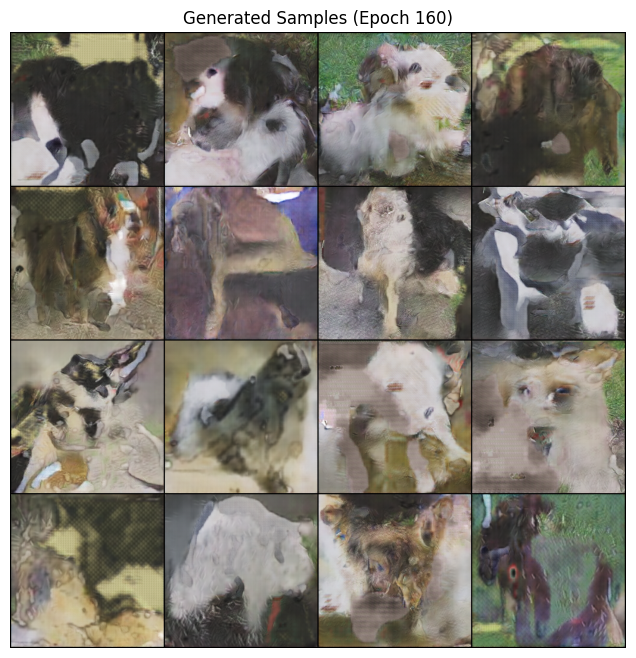

Epoch 161/200 completed in 121.67s


Epoch 162/200 completed in 120.63s


Epoch 163/200 completed in 120.01s


Epoch 164/200 completed in 124.03s


Epoch 165/200 completed in 121.77s


Epoch 166/200 completed in 122.05s


Epoch 167/200 completed in 124.01s


Epoch 168/200 completed in 117.48s


Epoch 169/200 completed in 123.53s


Epoch 170/200 completed in 120.98s


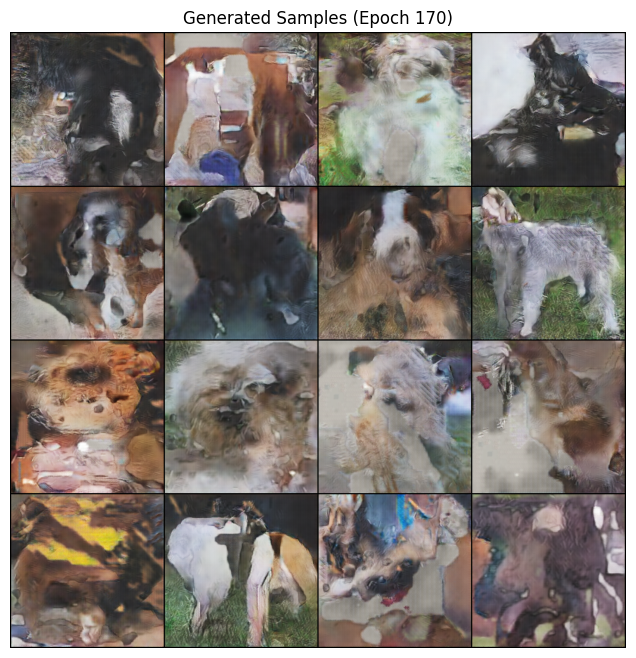

Epoch 171/200 completed in 124.11s


Epoch 172/200 completed in 123.19s


Epoch 173/200 completed in 123.99s


Epoch 174/200 completed in 125.44s


Epoch 175/200 completed in 133.34s


Epoch 176/200 completed in 133.47s


Epoch 177/200 completed in 131.93s


Epoch 178/200 completed in 133.19s


Epoch 179/200 completed in 126.50s


Epoch 180/200 completed in 130.09s


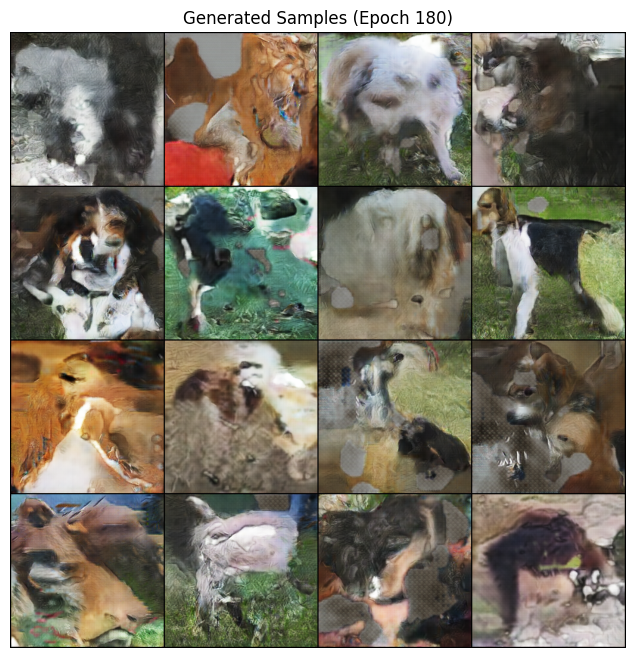

Epoch 181/200 completed in 129.27s


Epoch 182/200 completed in 129.46s


Epoch 183/200 completed in 129.66s


Epoch 184/200 completed in 129.56s


Epoch 185/200 completed in 125.09s


Epoch 186/200 completed in 127.75s


Epoch 187/200 completed in 133.82s


Epoch 188/200 completed in 135.57s


Epoch 189/200 completed in 129.21s


Epoch 190/200 completed in 132.16s


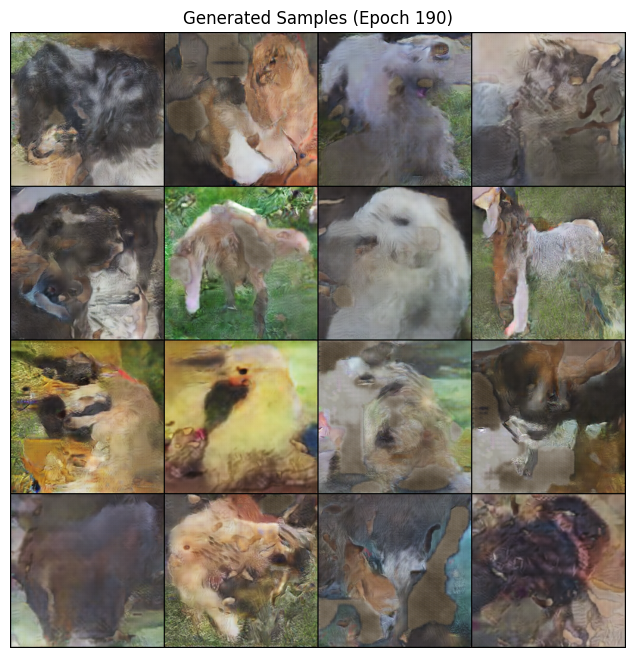

Epoch 191/200 completed in 134.53s


Epoch 192/200 completed in 123.74s


Epoch 193/200 completed in 133.87s


Epoch 194/200 completed in 126.87s


Epoch 195/200 completed in 132.21s


Epoch 196/200 completed in 132.29s


Epoch 197/200 completed in 131.04s


Epoch 198/200 completed in 127.02s


Epoch 199/200 completed in 131.90s


Epoch 200/200 completed in 127.37s


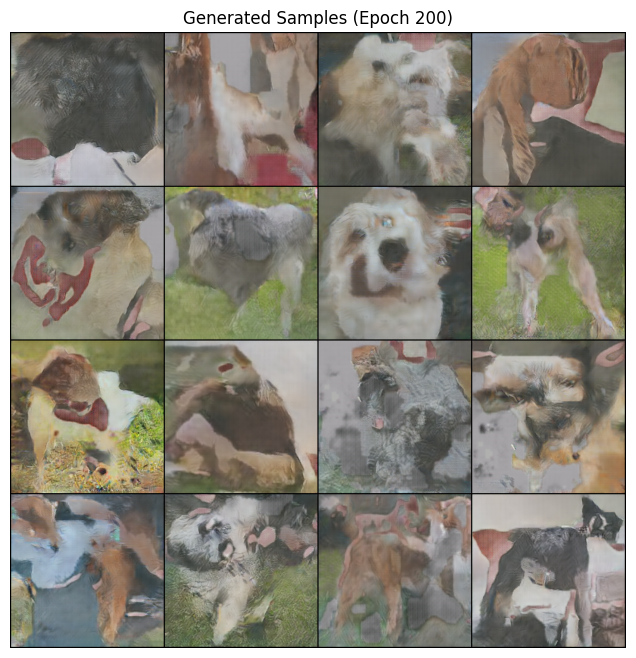

In [55]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
generator = Generator256(noise_dim=100, num_classes=len(dataset.class_names))
discriminator = Discriminator256(num_classes=len(dataset.class_names))

train_cgan(generator, discriminator, dataloader, num_epochs=200, noise_dim=100, num_classes=len(dataset.class_names), device=device)